# Example Notebook for Correcting and loading FastCCD Images

This example reads data from the FastCCD and corrects and rotates the images. Included are some
example of widgets to interact with the data

## Getting Started

Load the ``databroker`` moudle, ``csxtools`` and various other dependencies

In [1]:
import numpy as np
from databroker import DataBroker, get_table
from csxtools.utils import get_fastccd_images
from csxtools.ipynb import image_stack_to_movie, show_image_stack
%matplotlib inline
from matplotlib import pyplot as plt

## Get the data!

Load the headers without the images (using ``fill=False``)

In [13]:
bgnd

{'descriptors': [{'data_keys': {'delta': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif-Ax:Del}Mtr.RBV'},
    'epu1_gap': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID-ID{EPU:1-Ax:Gap}Pos-I'},
    'epu1_phase': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID-ID{EPU:1-Ax:Phase}Pos-I'},
    'epu2_gap': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID-ID{EPU:2-Ax:Gap}Pos-I'},
    'epu2_phase': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID-ID{EPU:2-Ax:Phase}Pos-I'},
    'eta': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Diag:1-Ax:Eta}Mtr.RBV'},
    'fccd_acquire_period': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{FCCD}cam1:AcquirePeriod_RBV'},
    'fccd_acquire_time': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{FCCD}cam1:AcquireTime_RBV'},
    'fccd_image_lightfield': {'dtype': 'array',
     'external': 'FILESTORE:',
     'shape': [1200, 960, 960],
     'source': 'PV:XF:23ID1-ES{FCCD}'},
    'fccd_stats_total1': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{FCCD}Stats1:Total_RBV'},
    'fccd_stats_total2': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{FCCD}Stats2:Total_RBV'},
    'fccd_stats_total3': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{FCCD}Stats3:Total_RBV'},
    'fccd_stats_total4': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{FCCD}Stats4:Total_RBV'},
    'fccd_stats_total5': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{FCCD}Stats5:Total_RBV'},
    'gamma': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif-Ax:Gam}Mtr.RBV'},
    'npbx': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif:Lens-Ax:BtmX}Mtr.RBV'},
    'npby': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif:Lens-Ax:BtmY}Mtr.RBV'},
    'npbz': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif:Lens-Ax:BtmZ}Mtr.RBV'},
    'nptx': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif:Lens-Ax:TopX}Mtr.RBV'},
    'npty': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif:Lens-Ax:TopY}Mtr.RBV'},
    'nptz': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif:Lens-Ax:TopZ}Mtr.RBV'},
    'pgm_energy': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-OP{Mono}Enrgy-I'},
    'ring_curr': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID-SR{}I-I'},
    'say': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif-Ax:Y}Mtr.RBV'},
    'saz': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Dif-Ax:Z}Mtr.RBV'},
    'sclr_chan1': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Sclr:1}.S1'},
    'sclr_chan2': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Sclr:1}.S2'},
    'sclr_chan3': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Sclr:1}.S3'},
    'sclr_chan4': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Sclr:1}.S4'},
    'sclr_chan5': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Sclr:1}.S5'},
    'sclr_chan6': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Sclr:1}.S6'},
    'sclr_chan7': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Sclr:1}.S7'},
    'sclr_chan8': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Sclr:1}.S8'},
    'sclr_time': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-ES{Sclr:1}.T'},
    'slt1_xc': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-OP{Slt:1-Ax:XCtr}Mtr.RBV'},
    'slt1_xg': {'dtype': 'number',
     'shape': [],
     'source': 'PV:XF:23ID1-OP{Slt:1-Ax:XGap}Mtr.RBV'},
    'slt1_yc': {'dtype': 'number',
     'shape': [],
   

In [8]:
bgnd = DataBroker['ce5042b7-00ae-49ca-9b11-b10c5661aaaa'] #[52440]
print(bgnd)
get_table(bgnd, fill=False)


header
  
  EventDescriptor
  ---------------
  +-----------------------+--------+------------+------------------+--------------------------------------------+
  | data keys             | dtype  |  external  |      shape       |                   source                   |
  +-----------------------+--------+------------+------------------+--------------------------------------------+
  | delta                 | number |            |        []        |     PV:XF:23ID1-ES{Dif-Ax:Del}Mtr.RBV      |
  | epu1_gap              | number |            |        []        |      PV:XF:23ID-ID{EPU:1-Ax:Gap}Pos-I      |
  | epu1_phase            | number |            |        []        |     PV:XF:23ID-ID{EPU:1-Ax:Phase}Pos-I     |
  | epu2_gap              | number |            |        []        |      PV:XF:23ID-ID{EPU:2-Ax:Gap}Pos-I      |
  | epu2_phase            | number |            |        []        |     PV:XF:23ID-ID{EPU:2-Ax:Phase}Pos-I     |
  | eta                   | number |     

,time,temp_a,saz,epu2_gap,delta,npbz,slt2_xg,npbx,fccd_stats_total1,temp_b,...,ring_curr,fccd_image_lightfield,nptz,sclr_chan7,slt1_xg,theta,slt2_xc,slt2_yc,slt1_yg,say
1,2015-10-22 00:10:38.185091-04:00,0,4.175332,31.020917,38.999985,-5.656265,10,-3.380105,137150246,0,...,150.056366,7180b59d-5112-428e-b6a4-9bc8893220b0,6.21667,0,6.9994,19.499985,1,-5.0001,7.0003,3.249713


In [3]:
data = DataBroker['b2596f8e-d220-4aea-8a55-8ccb17cbdacc'] #[52436]
get_table(data, fill=False)

,time,temp_a,saz,epu2_gap,delta,npbz,slt2_xg,npbx,fccd_stats_total1,temp_b,...,ring_curr,fccd_image_lightfield,nptz,sclr_chan7,slt1_xg,theta,slt2_xc,slt2_yc,slt1_yg,say
1,2015-10-21 23:59:54.531477-04:00,0,4.175332,31.020912,38.999985,-5.65627,10,-3.38011,137233260,0,...,150.018917,20eed5d8-05e2-4b0e-bd3c-5edae7b15878,6.216685,0,6.9994,19.499985,1,-5.0001,7.0003,3.249713


## Correct the FastCCD Images

Now correct the CCD images, using only a single background image. 

In the future this should be taken from the metadata associated with the data, or from the darkfield entry

In [4]:
images = get_fastccd_images(data, (bgnd, None, None))

## Now lets do an interactive plotting widget!

Thanks ``ipywidgets``!

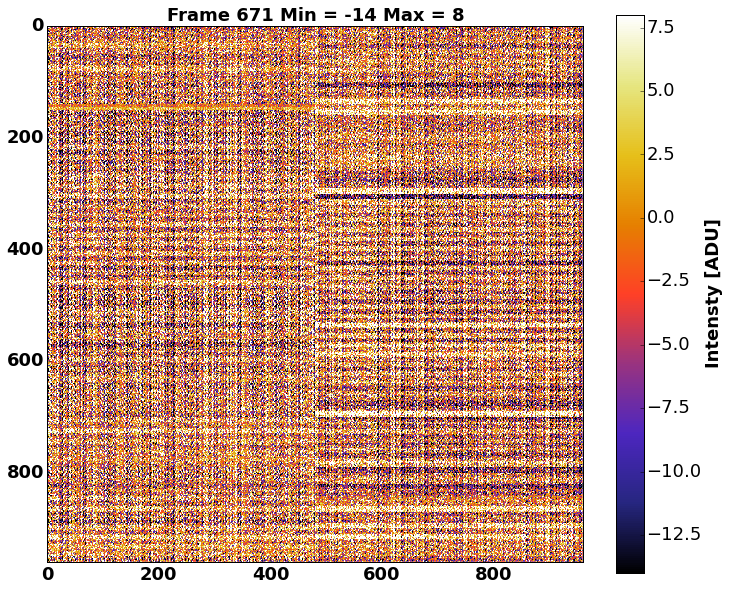

In [9]:
show_image_stack(images, (-100, 100))

## And lets do a movie of the stack of images
This produces an HTML5 movie which can be viewed in most browsers

In [6]:
image_stack_to_movie(images, frames=100, figsize=(12, 10), vmin=-20, vmax=20)

What version are we running?

In [7]:
import csxtools
csxtools.__version__

'0+untagged.55.gd85252e.dirty'